# Метрики

**CLIP-I** - среднее попарное косинусное сходство между сгенерированными и настоящими картинкой в латентном пространстве эмбеддингов модели CLIP

**CLIP-T** - среднее косинусное сходство между сгенерированными картинками и базовым промптом в пространстве модели CLIP

**G-R** - среднее косинусное сходство между сгенерированными картинками и контекстными промптами в пространстве модели CLIP

In [1]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

sns.set_theme(style="whitegrid", palette=sns.color_palette("Set2"))

In [2]:
# Load the example diamonds dataset
data = pd.read_excel('metrics_svdiff_attn.xlsx')

def label_point(x, y, rank, ax):
    a = pd.concat({'x': x, 'y': y, 'rank': rank}, axis=1)
    for i, point in a.iterrows():
        ax.text(point['x'], point['y'], point['rank'])

data['CLIP-I'] = data['CLIP-I'].astype(float)
data['CLIP-T'] = data['CLIP-T'].astype(float)
data['G-R'] = data['G-R'].astype(float)

## Все концепты

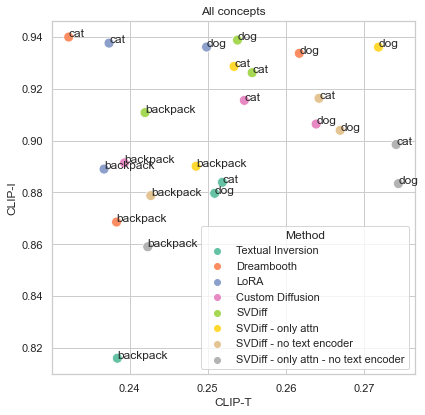

In [3]:
# Draw a scatter plot while assigning point colors and sizes to different
# variables in the dataset
f, ax = plt.subplots(figsize=(6.5, 6.5))

sns.scatterplot(x="CLIP-T", y="CLIP-I",
                hue="Method",
                data=data, ax=ax,
                s=100).set(title='All concepts')

label_point(data["CLIP-T"], data["CLIP-I"], data["Concept"], plt.gca())

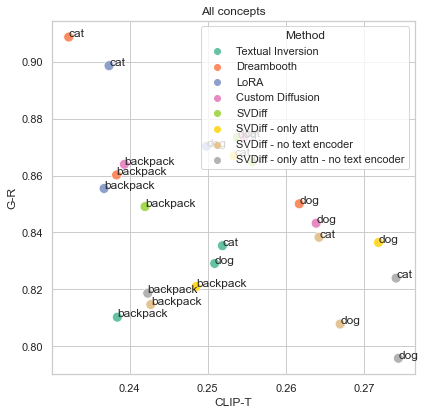

In [4]:
f, ax = plt.subplots(figsize=(6.5, 6.5))

sns.scatterplot(x="CLIP-T", y="G-R",
                hue="Method",
                data=data, ax=ax,
                s=100).set(title='All concepts')

label_point(data["CLIP-T"], data["G-R"], data["Concept"], plt.gca())

## Отдельно по концептам

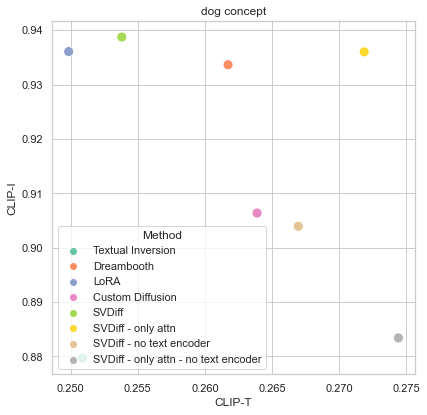

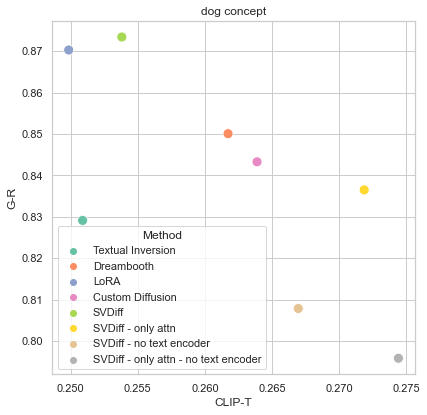

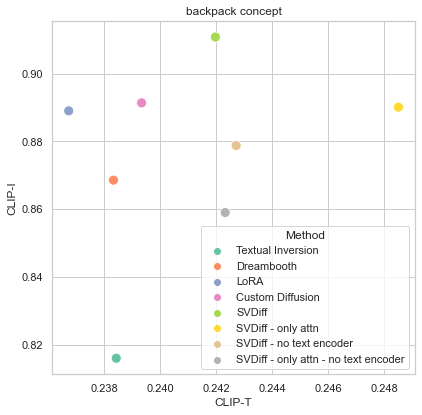

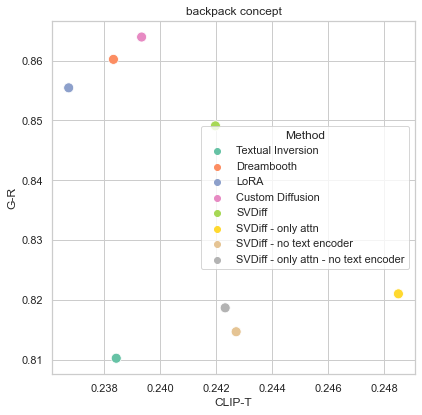

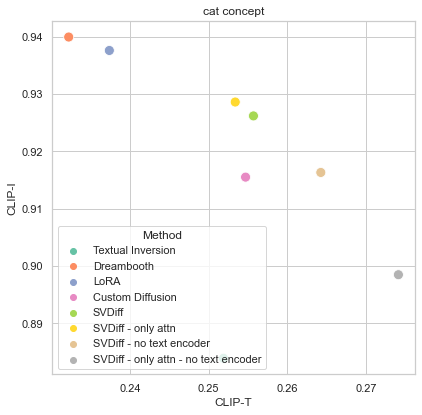

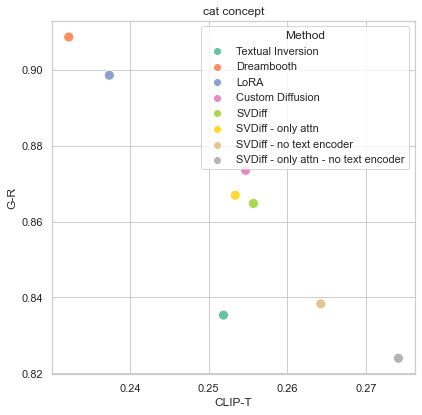

In [5]:
for concept in data["Concept"].unique():
    f, ax = plt.subplots(figsize=(6.5, 6.5))
    
    concept_data = data[data["Concept"] == concept]
    sns.scatterplot(x="CLIP-T", y="CLIP-I",
                hue="Method",
                data=concept_data, ax=ax,
                s=100).set(title=f'{concept} concept')
    
    f, ax = plt.subplots(figsize=(6.5, 6.5))
    sns.scatterplot(x="CLIP-T", y="G-R",
                hue="Method",
                data=concept_data, ax=ax,
                s=100).set(title=f'{concept} concept')

# Примеры сгенерированных изображений

In [ ]:
from glob import glob
import random
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import os

from mpl_toolkits.axes_grid1 import ImageGrid

def get_examples(prompts_path):
    images_with_prompts = []
    last_prompt = ''
    for prompts_file in glob(prompts_path + '/*.txt'):
        filename, ext = os.path.basename(prompts_file).split('.')
        prompt = filename.split('_')[0]
        if prompt == last_prompt:
            continue

        n_gen_images = len(glob(f'{prompts_path}/{prompt}*.png'))
        id_image = random.randint(0, n_gen_images - 1)

        img = Image.open(f'{prompts_path}/{prompt}_{id_image}.png')
        
        images_with_prompts.append((prompt, img))
        
        last_prompt = prompt
    return images_with_prompts
    
def draw_examples(images_with_prompts):
    fig = plt.figure(figsize=(25., 25.))
    grid = ImageGrid(fig, 111,  # similar to subplot(111)
                     nrows_ncols=(5, 5),
                     axes_pad=1
                     )

    for ax, im in zip(grid, images_with_prompts):
        ax.imshow(im[1])
        ax.set_title(im[0])
        ax.grid(False)

    plt.show()

### SVDiff only attention

Concept: dog6

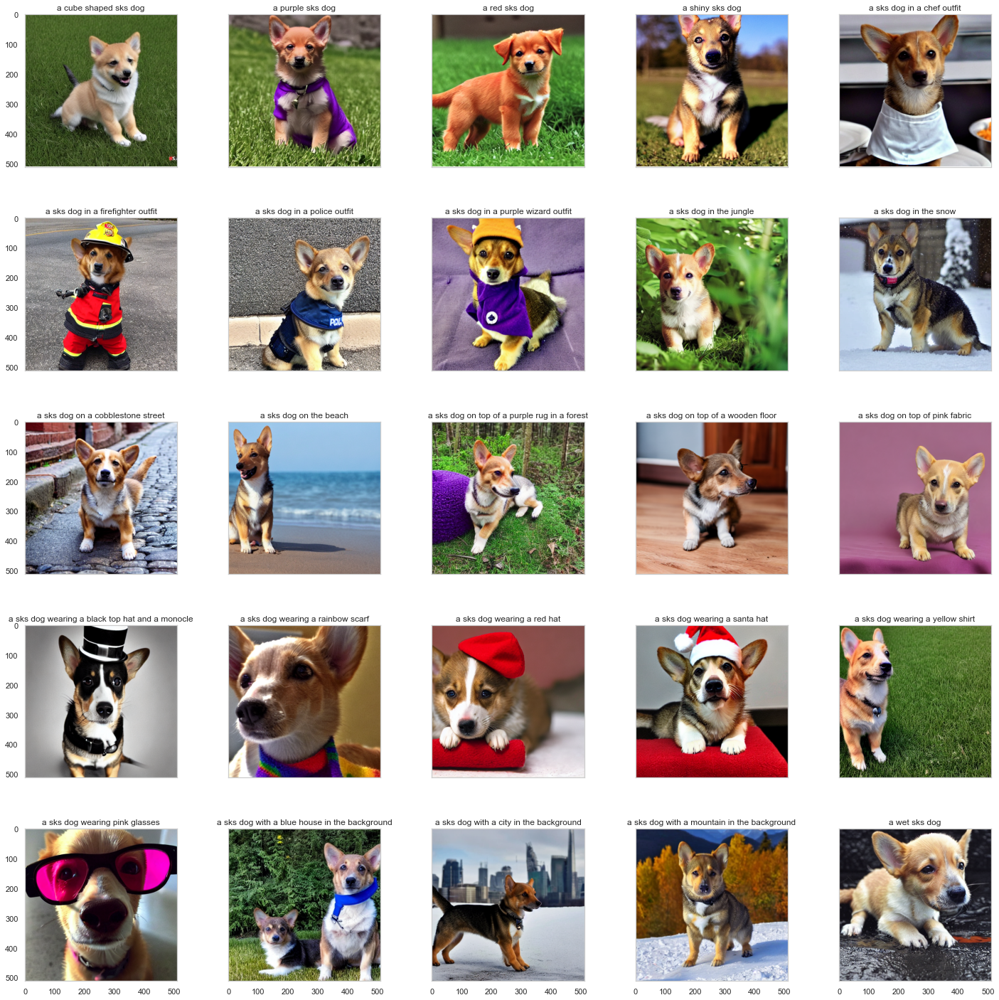

In [ ]:
examples = get_examples('../inference/generated_images/dog/t2i/svdiff_attn')
draw_examples(examples)

Concept: backpack

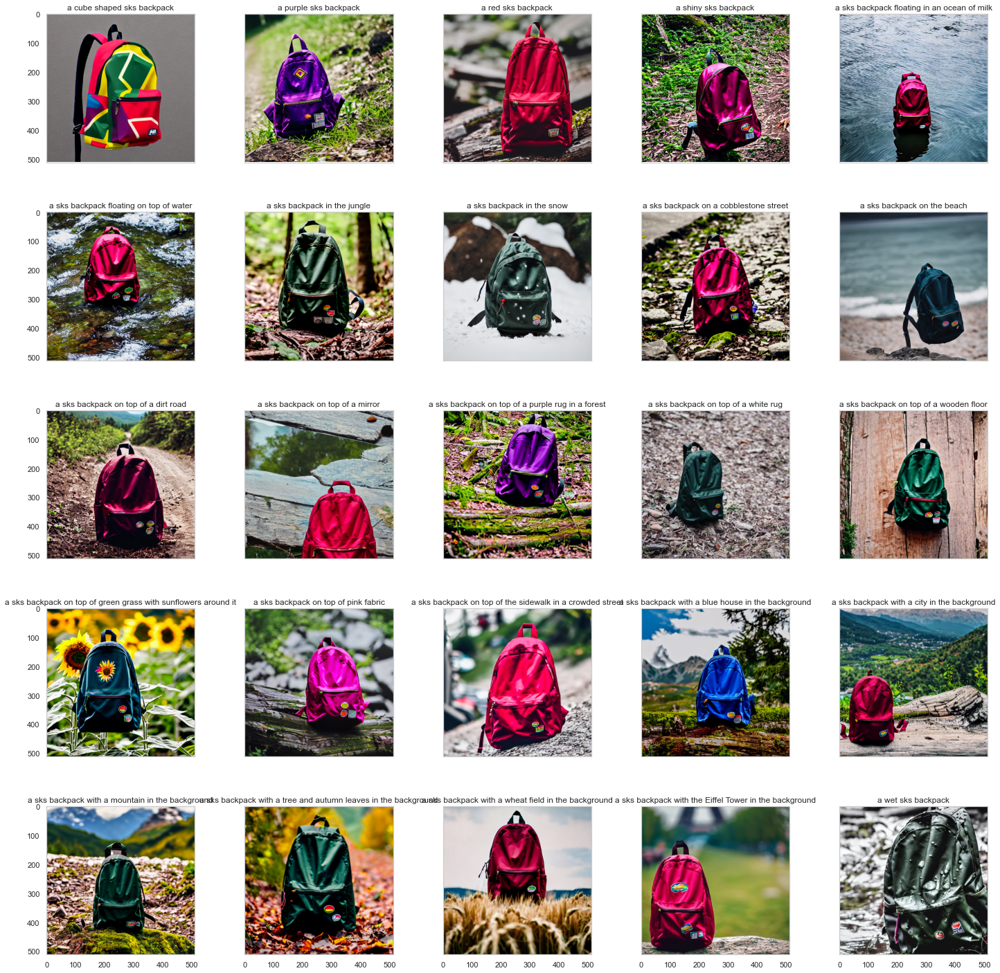

In [ ]:
examples = get_examples('../inference/generated_images/backpack/t2i/svdiff_attn')
draw_examples(examples)

Concept: cat

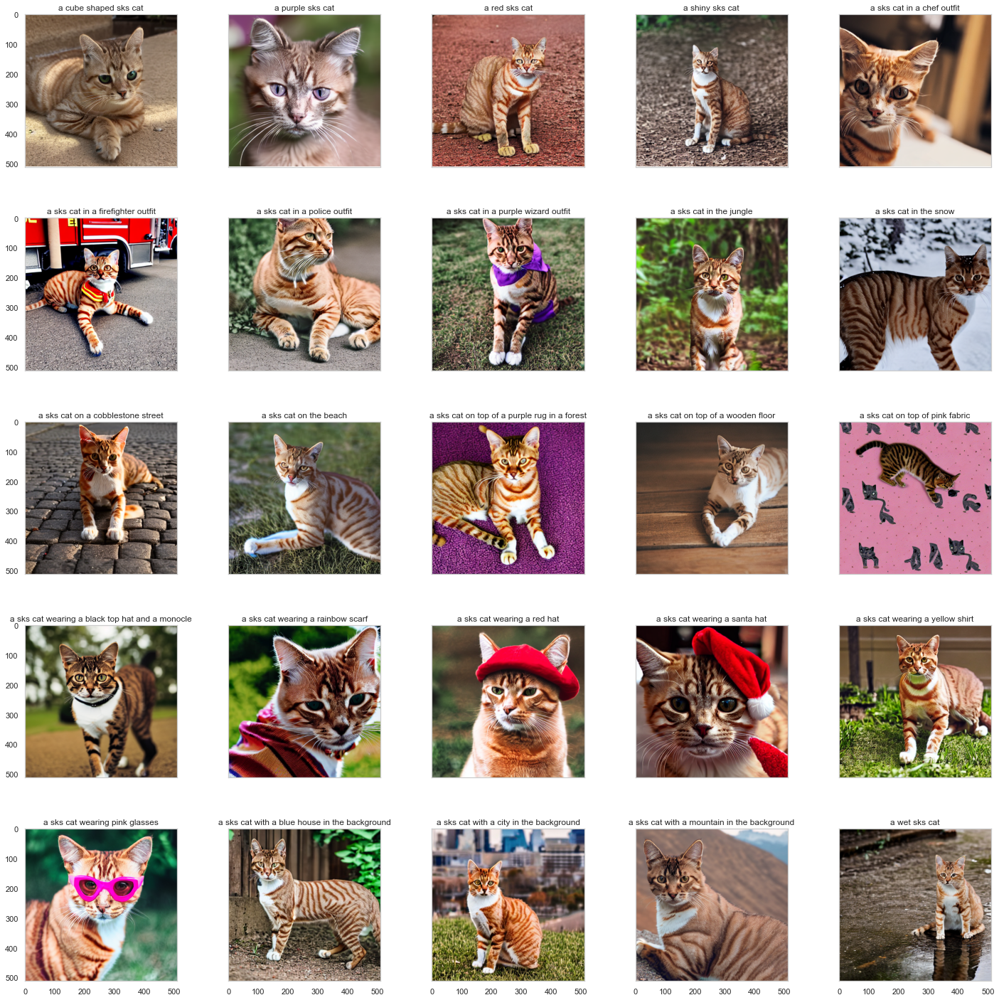

In [ ]:
examples = get_examples('../inference/generated_images/cat/t2i/svdiff_attn')
draw_examples(examples)

### SVDiff no text encoder

Concept: dog6

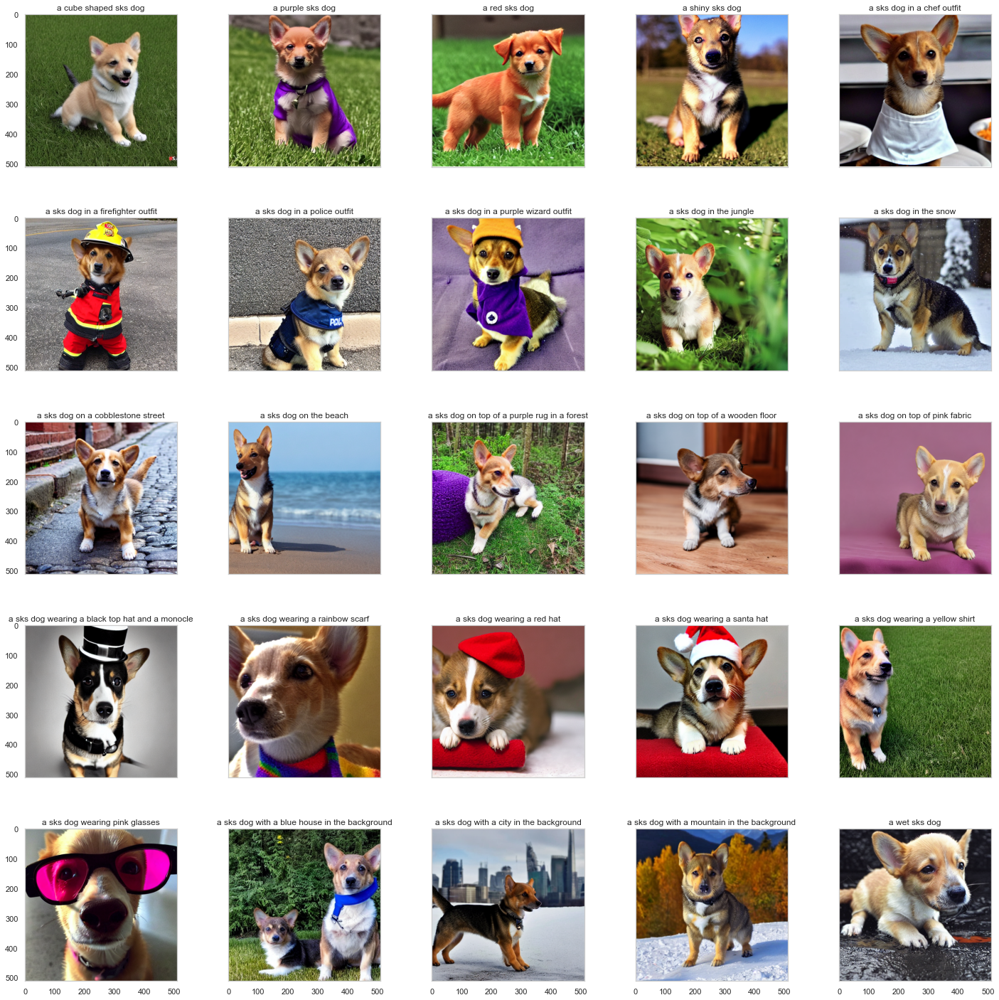

In [ ]:
examples = get_examples('../inference/generated_images/dog/t2i/svdiff_no_text_encoder')
draw_examples(examples)

Concept: backpack

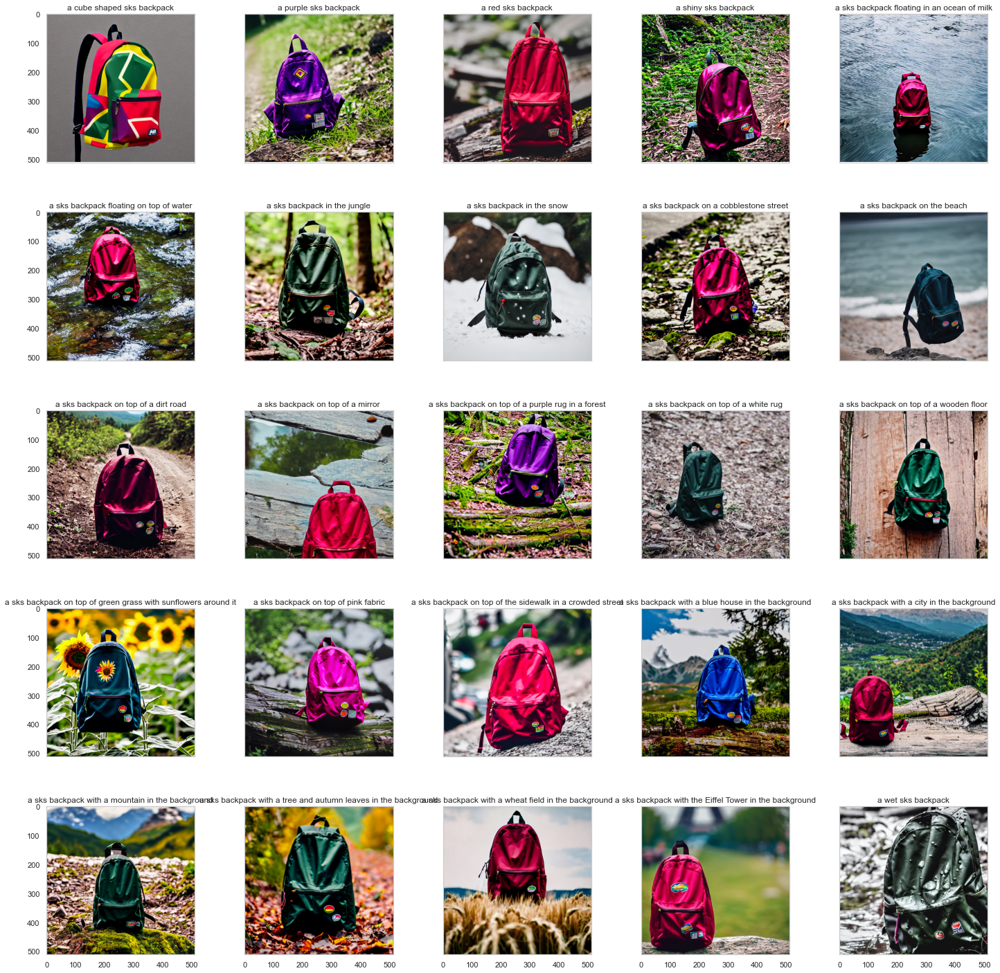

In [ ]:
examples = get_examples('../inference/generated_images/backpack/t2i/svdiff_no_text_encoder')
draw_examples(examples)

Concept: cat

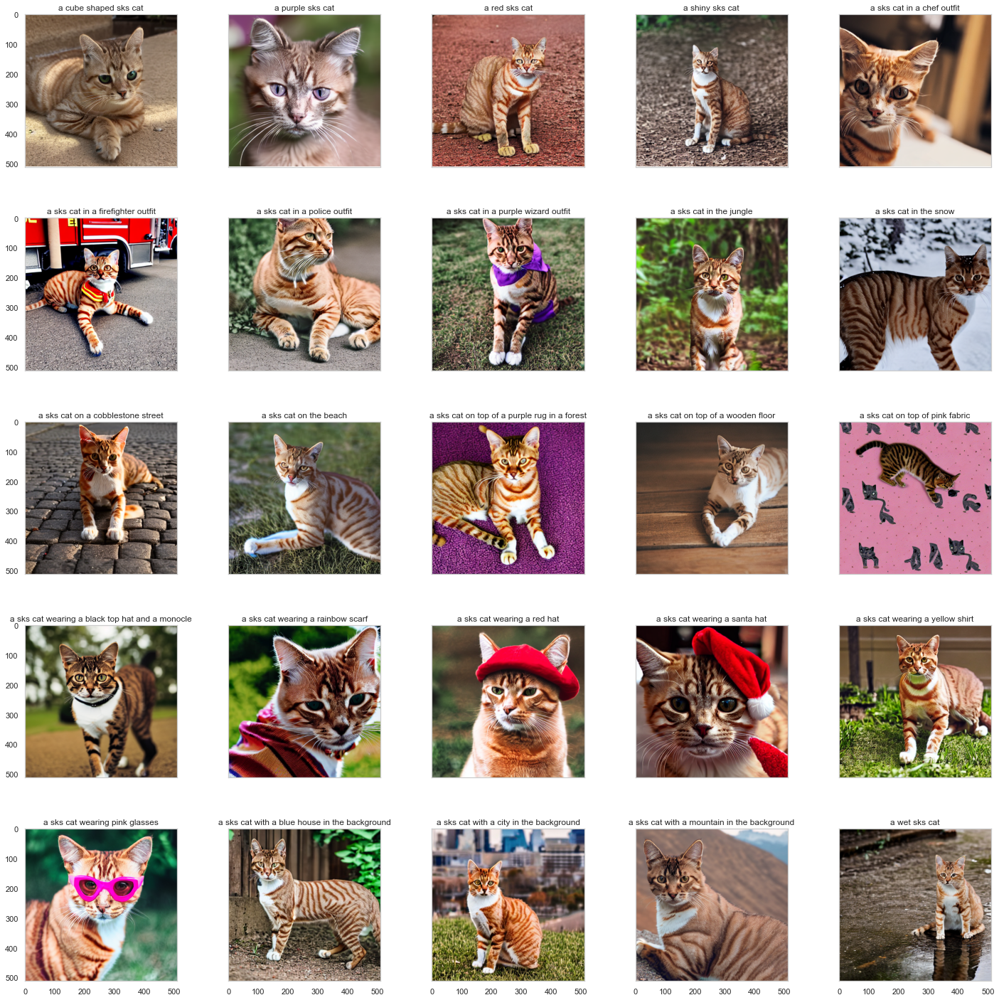

In [ ]:
examples = get_examples('../inference/generated_images/cat/t2i/svdiff_no_text_encoder')
draw_examples(examples)

### SVDiff only attn no text encoder

Concept: dog6

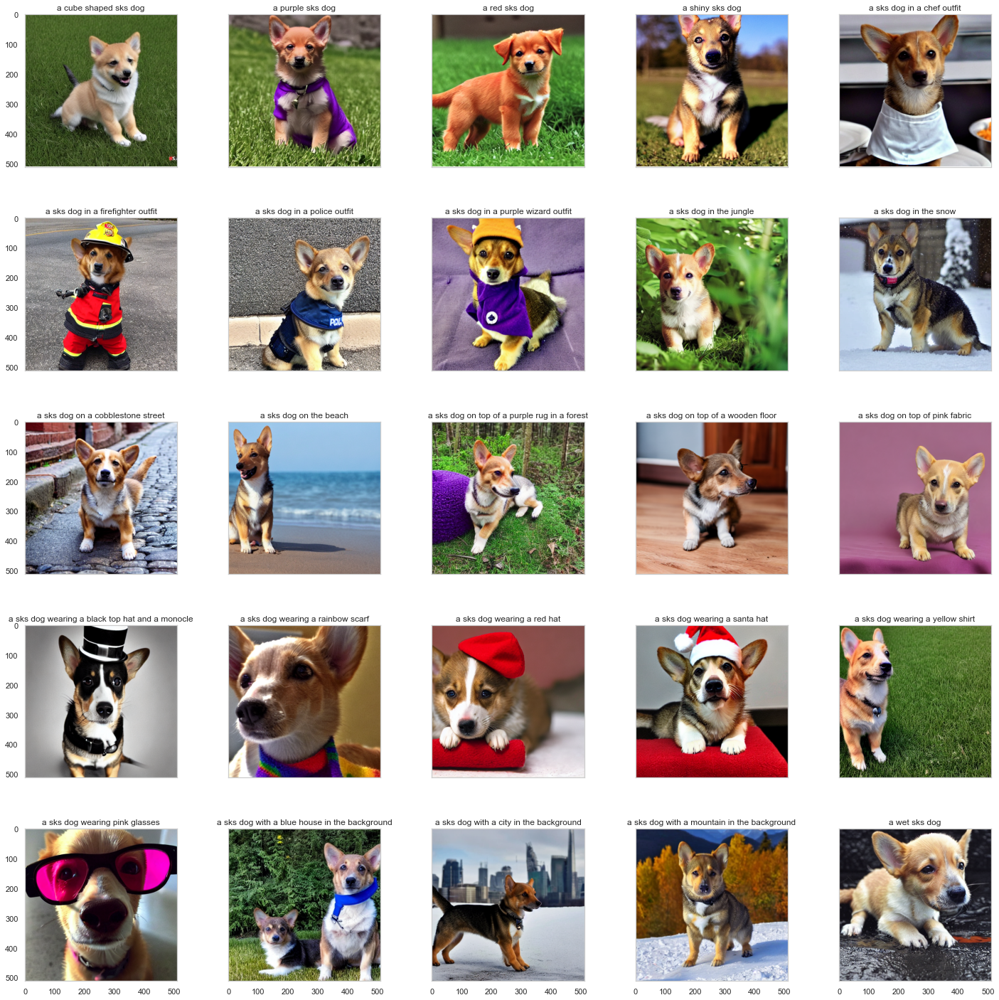

In [ ]:
examples = get_examples('../inference/generated_images/dog/t2i/svdiff_attn_no_text_encoder')
draw_examples(examples)

Concept: backpack

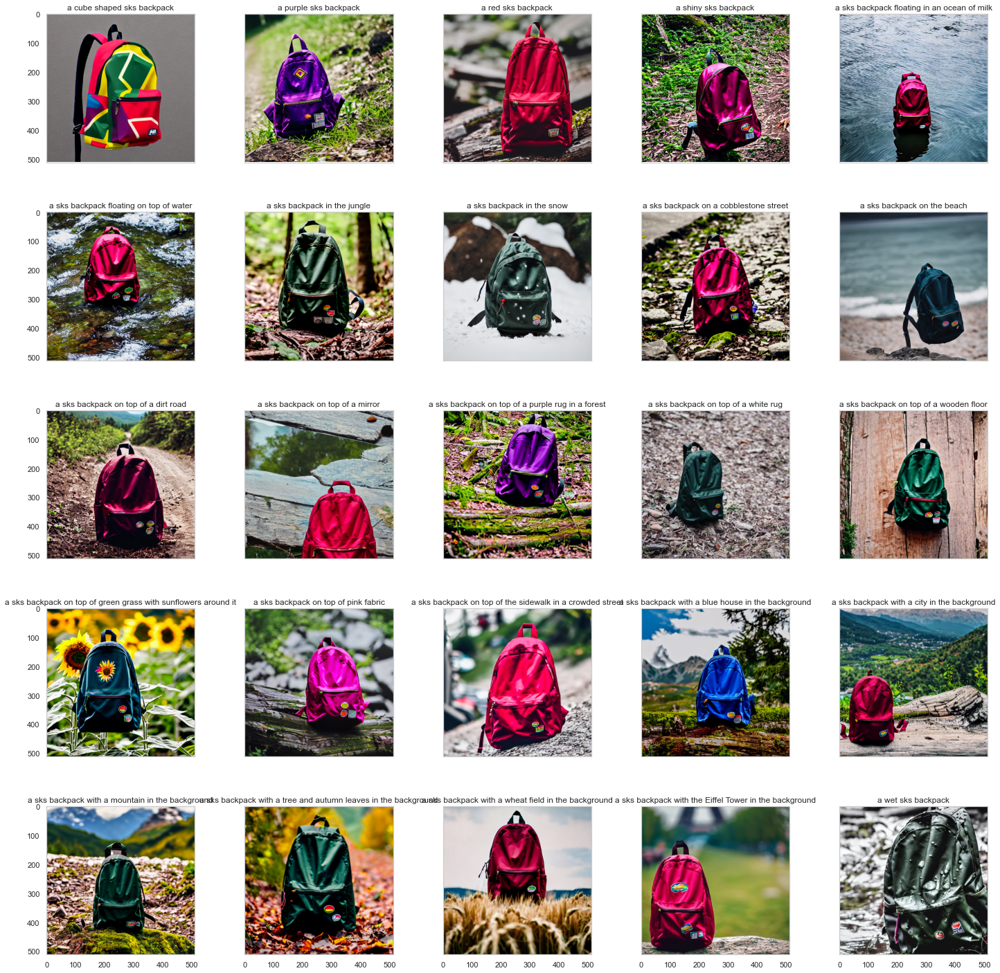

In [ ]:
examples = get_examples('../inference/generated_images/backpack/t2i/svdiff_attn_no_text_encoder')
draw_examples(examples)

Concept: cat

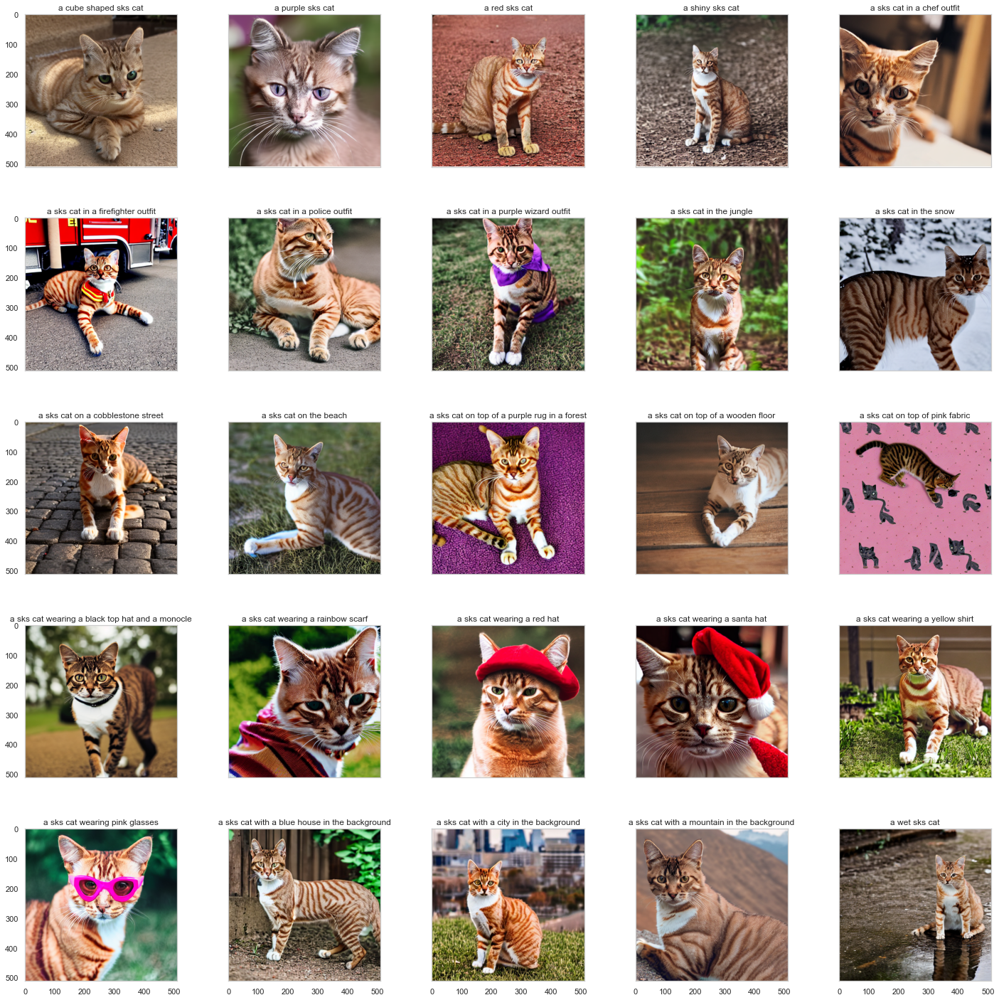

In [ ]:
examples = get_examples('../inference/generated_images/cat/t2i/svdiff_attn_no_text_encoder')
draw_examples(examples)